### Importing the required packages

In [27]:
import numpy as np 
import pandas as pd
from PIL import Image #For reading images
import glob #For reading the files
import re # For RegEx
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import cv2

### Function to read an image

In [107]:
def load_image(infilename):
    img = Image.open( infilename )
    img.load()
    data = np.asarray( img, dtype="int32" )
    return data

In [108]:
#Getting sub directories under the main folder
#Note the file name here, I've named my folder as Repair_Damage_2
main_folder = "Repair_Damage_2/*"
folders = glob.glob(main_folder)
print(folders)

['Repair_Damage_2/Repair_defects', 'Repair_Damage_2/No_defects']


### Reading all the images and annotation files

In [109]:
#For dynamically creating lists
g = globals()

#['Repair_Damage/Repair_defects', 'Repair_Damage/No_defects']
#Iterating over the above folders
for folder in folders:
    list_name = folder.split('/')[1]
    g[list_name+'_T'] = [] #Empty list to store Thermal Images
    g[list_name+'_V'] = [] #Empty list to store Normal Images
    
    g[list_name+'_T_Order'] = [] #Empty list to store Thermal Images
    g[list_name+'_V_Order'] = [] #Empty list to store Normal Images
    print("\nDynamically created lists:")
    print(list_name+'_T')
    print(list_name+'_V')
    print(list_name+'_T_Order')
    print(list_name+'_V_Order')
    
    #path to find all files under each folder
    fn_path_allfiles = folder+'/*'
    #path to find all csv file(s)(file with annotations) under each folder
    fn_path_csvfile = folder+'/*.csv'
    
    #Obtaining path of all csv files under each folder
    file_csv = glob.glob(fn_path_csvfile)
    #Obtaining path of all files under each folder
    file_all = glob.glob(fn_path_allfiles)
    
    #Dataframe to store annotations
    df_name = 'df_'+folder.split('/')[1]
    print("\nDynamically created a Dataframe:")
    print(df_name)
    vars()[df_name] = pd.read_csv(file_csv[0])
    
    #We only need to iterate over the folders Pair_1, Pair_2...etc.
    required_folders = list(set(file_all)^set(file_csv))
    
    for image_folder in required_folders:
        #Obtaining the path of the images under each folder
        images_path = image_folder+"/*"
        images = (glob.glob(images_path))
        #Iterating over the images
        for img in images:
            span_flag = 0
            if folder.split('/')[1] == 'Repair_defects':
                #Appending thermal images to a different list
                if re.search('T.jpg', img):
                    if re.search('\d\dT.jpg', img):
                        span = re.search('\d\dT.jpg', img).span()
                        span_flag = 1
                    if span_flag==0:
                        span = re.search('\dT.jpg', img).span()
                    start_index = span[0]
                    end_index = span[1]
                    g[list_name+'_T_Order'].append(img[start_index:end_index])
                    g[list_name+'_T'].append(load_image(img))
            
            #Appending regular images to a different list
                elif re.search('V.jpg', img):
                    if re.search('\d\dV.jpg', img):
                        span = re.search('\d\dV.jpg', img).span()
                        span_flag = 1
                    if span_flag==0:
                        span = re.search('\dV.jpg', img).span()
                    start_index = span[0]
                    end_index = span[1]
                    g[list_name+'_V_Order'].append(img[start_index:end_index])
                    g[list_name+'_V'].append(load_image(img))
            
            if folder.split('/')[1] == 'No_defects':
                #print("Name:",img)
                if re.search('NT.jpg', img):
                    if re.search('\d\dNT.jpg', img):
                        span = re.search('\d\dNT.jpg', img).span()
                        span_flag = 1
                    if span_flag==0:
                        span = re.search('\dNT.jpg', img).span()
                    start_index = span[0]
                    end_index = span[1]
                    g[list_name+'_T_Order'].append(img[start_index:end_index])
                    g[list_name+'_T'].append(load_image(img))
                    #print("Appended to list:",list_name)
                elif re.search('NV.jpg', img):
                    if re.search('\d\dNV.jpg', img):
                        span = re.search('\d\dNV.jpg', img).span()
                        span_flag = 1
                    if span_flag==0:
                        span = re.search('\dNV.jpg', img).span()
                    start_index = span[0]
                    end_index = span[1]
                    g[list_name+'_V_Order'].append(img[start_index:end_index])
                    g[list_name+'_V'].append(load_image(img))
                    #print("Appended to list:",list_name)


Dynamically created lists:
Repair_defects_T
Repair_defects_V
Repair_defects_T_Order
Repair_defects_V_Order

Dynamically created a Dataframe:
df_Repair_defects

Dynamically created lists:
No_defects_T
No_defects_V
No_defects_T_Order
No_defects_V_Order

Dynamically created a Dataframe:
df_No_defects


Note Changes 2NV.jpg ,10NV.JPG and 12NV.JPG<br>

jpg should be in lower case, for both image names and in the CSV file

### Displaying all Thermal images with defects

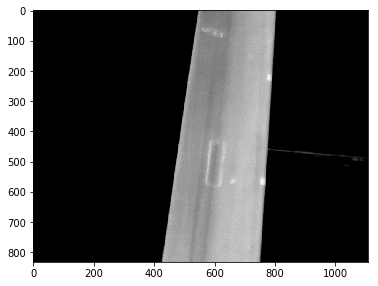

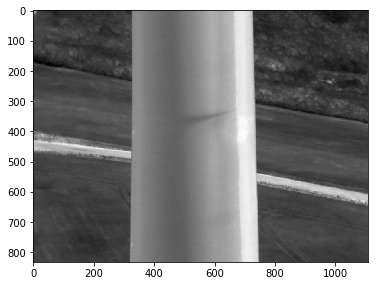

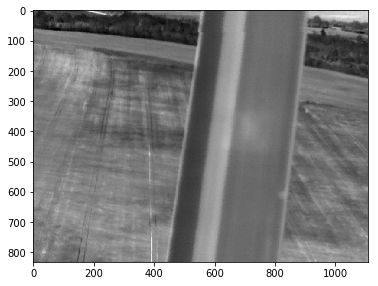

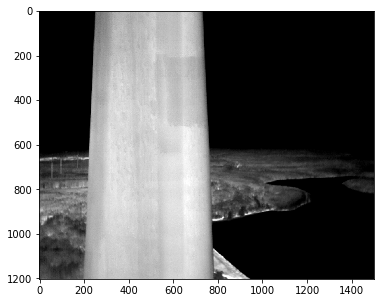

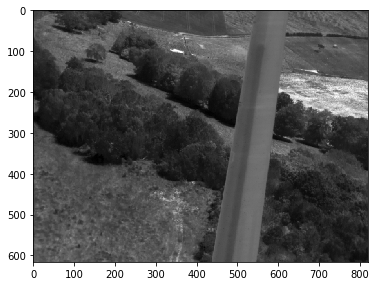

...

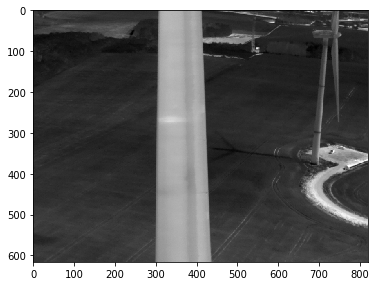

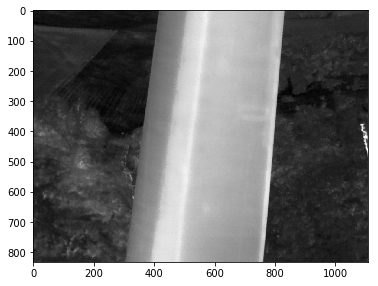

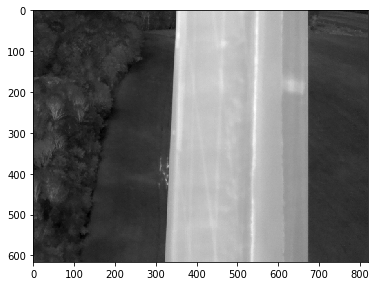

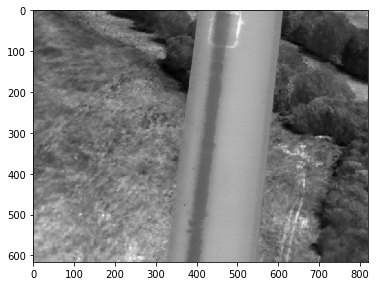

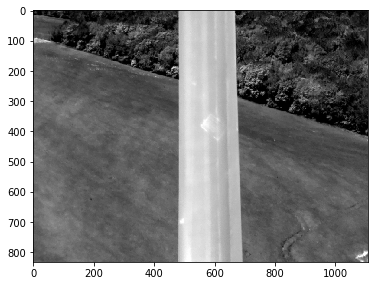

In [110]:
for img in Repair_defects_T:
    plt.figure(figsize=(6,6))
    plt.imshow(img)

### Displaying all Visual images with defects

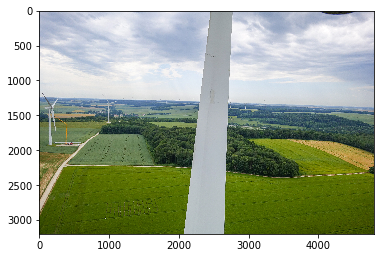

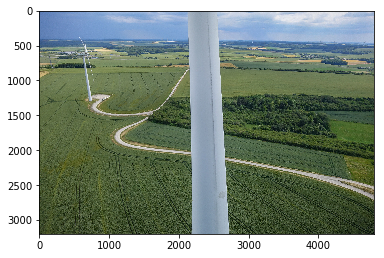

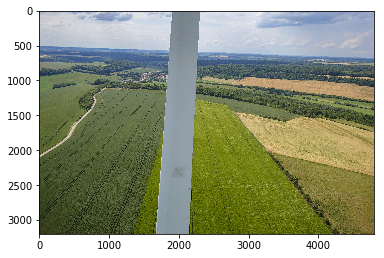

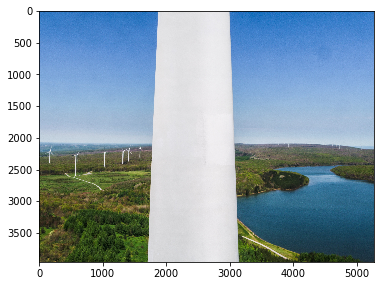

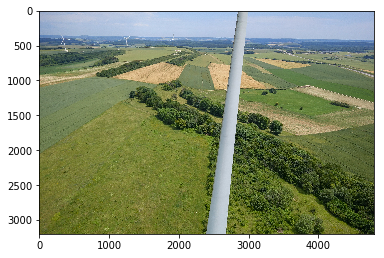

...

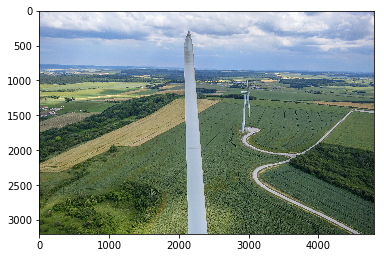

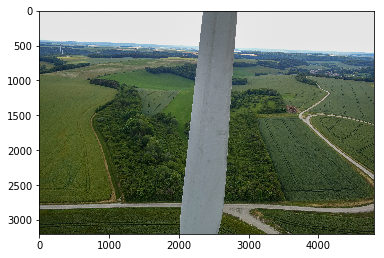

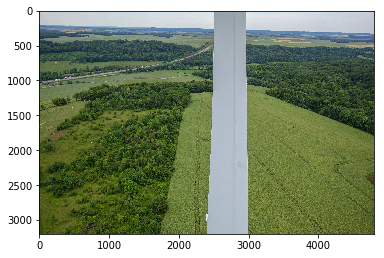

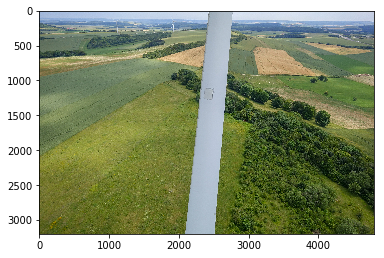

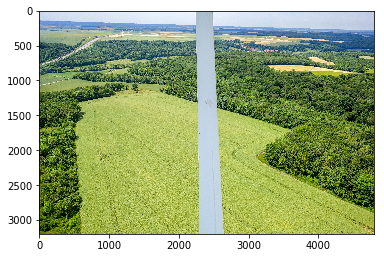

In [111]:
for img in Repair_defects_V:
    plt.figure(figsize=(6,6))
    plt.imshow(img)

### Annotation dataframe of images with defects

In [112]:
df_Repair_defects.head()

,Annotation id,Image id,WKT coordinates,Date,Filename,Damage id,Damage name,Severity,Remedy action,User tags,"Position (lat, long)",Altitude,Heading,Camera,Resolution,Google maps,Link,Comments
0,460271,2699718,"POLYGON ((0.38 0.452, 0.499 0.452, 0.499 0.42,...",NaN,9T.jpg,251,POI,0,NaN,Repair Sites | Pair 9,NaN,NaN,NaN,NaN,820x616,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN
1,460272,2699718,"POLYGON ((0.379 0.993, 0.5 0.993, 0.5 0.002, 0...",NaN,9T.jpg,3143,Large Bounding Box,0,NaN,Repair Sites | Pair 9,NaN,NaN,NaN,NaN,820x616,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN
2,460279,2699722,"POLYGON ((0.583 0.614, 0.61 0.614, 0.61 0.551,...",NaN,7T.jpg,251,POI,0,NaN,Repair Sites | Pair 7,NaN,NaN,NaN,NaN,820x616,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN
3,460280,2699722,"POLYGON ((0.541 0.989, 0.749 0.989, 0.749 0.00...",NaN,7T.jpg,3143,Large Bounding Box,0,NaN,Repair Sites | Pair 7,NaN,NaN,NaN,NaN,820x616,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN
4,460273,2699719,"POLYGON ((0.441 0.626, 0.481 0.626, 0.481 0.59...","Jun 19, 2019 10:44:23 AM",9V.jpg,251,POI,0,NaN,Repair Sites | Pair 9,NaN,NaN,NaN,SONY DSC-RX0,4800x3200,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN


### Displaying all Thermal images without defects

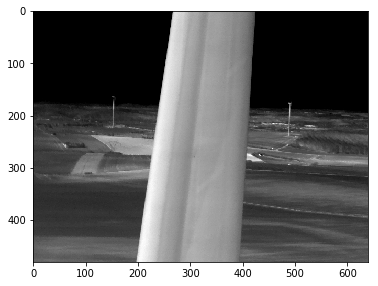

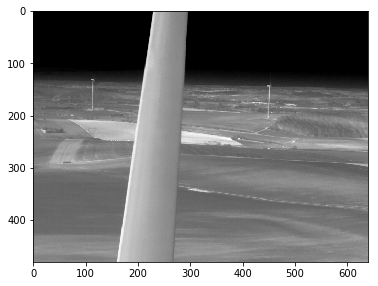

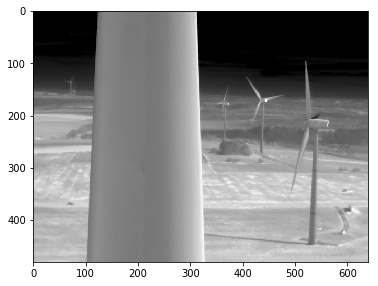

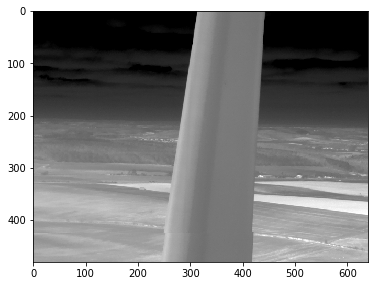

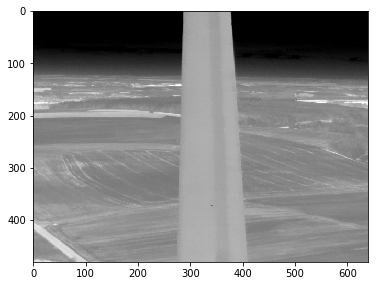

...

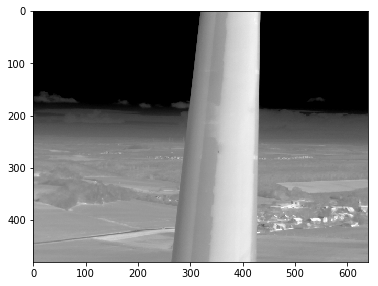

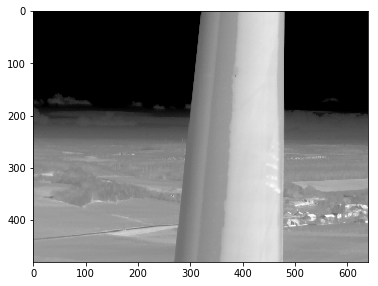

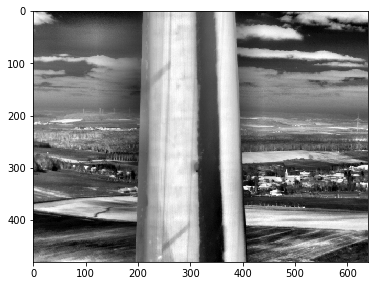

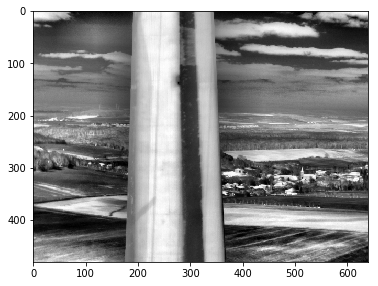

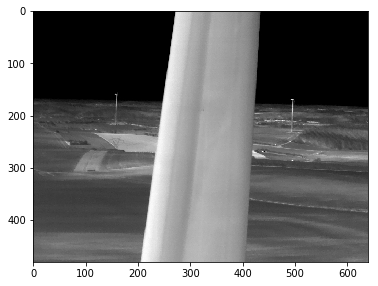

In [113]:
for img in No_defects_T:
    plt.figure(figsize=(6,6))
    plt.imshow(img)

### Displaying all Visual images without defects

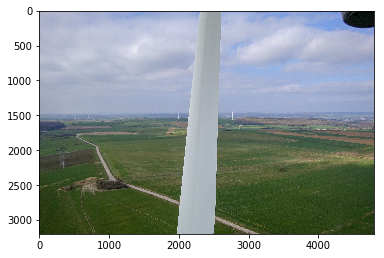

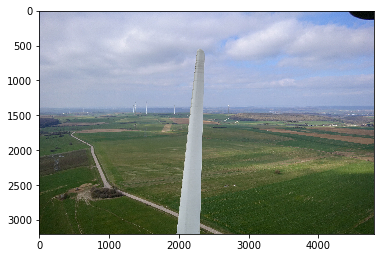

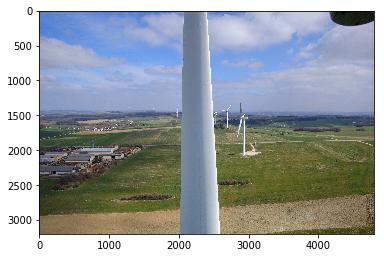

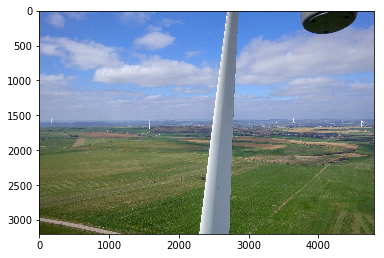

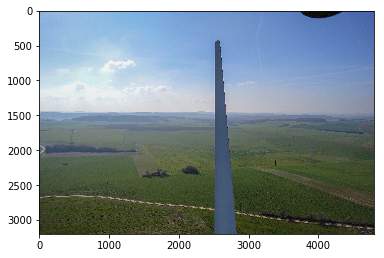

...

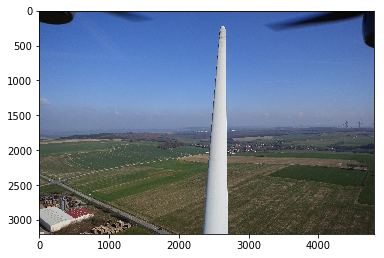

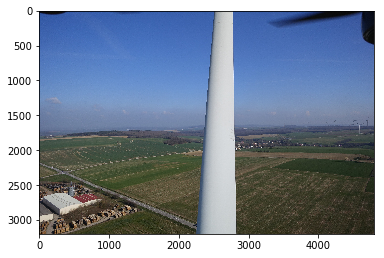

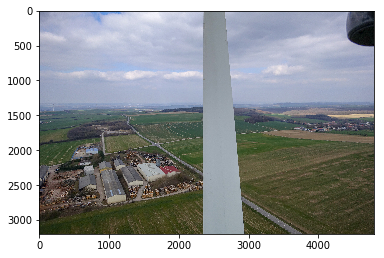

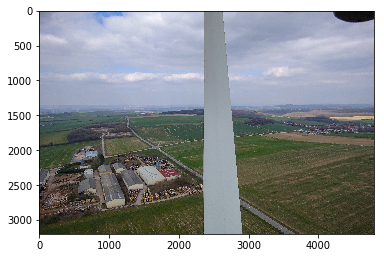

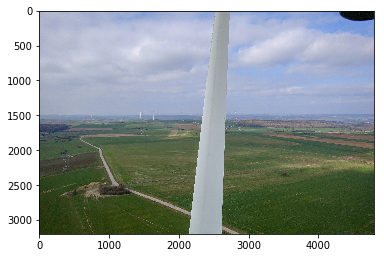

In [114]:
for img in No_defects_V:
    plt.figure(figsize=(6,6))
    plt.imshow(img)

### Annotation dataframe of images without defects

In [115]:
df_No_defects.head()

,Annotation id,Image id,WKT coordinates,Date,Filename,Damage id,Damage name,Severity,Remedy action,User tags,"Position (lat, long)",Altitude,Heading,Camera,Resolution,Google maps,Link,Comments
0,479759,2849161,"POLYGON ((0.494 0.996, 0.642 0.996, 0.642 0.00...",NaN,7NT.jpg,3143,Large Bounding Box,0,NaN,Without_Strike_Damage | Pair_7,NaN,NaN,NaN,NaN,640x480,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN
1,479760,2849162,"POLYGON ((0.499 0.998, 0.598 0.998, 0.598 0.00...",3/26/19 8:45,7NV.jpg,3143,Large Bounding Box,0,NaN,Without_Strike_Damage | Pair_7,NaN,NaN,NaN,SONY DSC-RX0,4800x3200,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN
2,479763,2849166,"POLYGON ((0.356 0.987, 0.638 0.987, 0.638 0.01...",NaN,1NT.jpg,3143,Large Bounding Box,0,NaN,Without_Strike_Damage | Pair_1,NaN,NaN,NaN,NaN,640x480,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN
3,479762,2849165,"POLYGON ((0.488 0.999, 0.527 0.999, 0.527 0.20...",3/26/19 8:47,9NT.jpg,3143,Large Bounding Box,0,NaN,Without_Strike_Damage | Pair_9,NaN,NaN,NaN,SONY DSC-RX0,4800x3200,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN
4,479761,2849164,"POLYGON ((0.392 0.993, 0.529 0.993, 0.529 0.00...",NaN,9NV.jpg,3143,Large Bounding Box,0,NaN,Without_Strike_Damage | Pair_9,NaN,NaN,NaN,NaN,640x480,NaN,https://datavue.abjdrones.com/index.html#/insp...,NaN


### Creating one numpy array with all images

In [116]:
full_dataset = []
full_dataset_order = []

full_dataset.extend(Repair_defects_T)
full_dataset.extend(Repair_defects_V)
full_dataset.extend(No_defects_T)
full_dataset.extend(No_defects_V)

full_dataset_order.extend(Repair_defects_T_Order)
full_dataset_order.extend(Repair_defects_V_Order)
full_dataset_order.extend(No_defects_T_Order)
full_dataset_order.extend(No_defects_V_Order)

full_dataset = np.array(full_dataset)

In [117]:
def get_df_name(df):
    name =[x for x in globals() if globals()[x] is df][0]
    return name

### Iterating over every observation in each annotation dataframe and extracting bounding box co-ordinates

In [118]:
dfs = [df_Repair_defects,df_No_defects]
df_names = ['df_Repair_defects','df_No_defects']

for i,df in enumerate(dfs):
    
    #Lists to store the co-ordinates
    bottom_left_X = []
    bottom_left_Y = []
    bottom_right_X = []
    bottom_right_Y = []
    top_right_X = []
    top_right_Y = []
    top_left_X = []
    top_left_Y = []
    
    #Getting df name
    df_name = df_names[i]
    #print(df_name)
    new_df_name = df_name+'_bounding_box'
    
    for row in df['WKT coordinates']:
        #Each observation has co-ordinates in the form -
        #"POLYGON ((BOTTOME LEFT, BOTTOM RIGHT, TOP RIGHT, TOP LEFT, BOTTOM LEFT))"
        #Extracting just the co-ordinates - BOTTOME LEFT, BOTTOM RIGHT, TOP RIGHT, TOP LEFT, BOTTOM LEFT
        span = re.search('\d', row).span()
        co_ordinates = row[span[0]:-2]
        co_ordinates_split = co_ordinates.split(',')
        
        #Iterating over each co-ordinate
        for i,elem in enumerate(co_ordinates_split):
            #Further stripping down each co-ordinate to X and Y storing them as floating points
            co_ordinates_split[i] = elem.strip()
            X_Y_elements = co_ordinates_split[i].split()
            X_Y_elements = [float(i) for i in X_Y_elements]
            if i == 0: 
                bottom_left_X.append(X_Y_elements[0])
                bottom_left_Y.append(X_Y_elements[1])
            if i == 1: 
                bottom_right_X.append(X_Y_elements[0])
                bottom_right_Y.append(X_Y_elements[1])
            if i == 2: 
                top_right_X.append(X_Y_elements[0])
                top_right_Y.append(X_Y_elements[1])
            if i == 3: 
                top_left_X.append(X_Y_elements[0])
                top_left_Y.append(X_Y_elements[1])
    
    #Forming a new data frame storing filename, actual co-ordinates, extracted co-ordinates and image dimensions            
    vars()[new_df_name] = pd.DataFrame({'Filename':df['Filename'],
                                        'Damage ID':df['Damage id'],
                                        'WKT coordinates':df['WKT coordinates'],
                                        'Bottom Left X':bottom_left_X,
                                        'Bottom Left Y':bottom_left_Y,
                                        'Bottom Right X':bottom_right_X,
                                        'Bottom Right Y':bottom_right_Y,
                                        'Top Right X':top_right_X,
                                        'Top Right Y':top_right_Y,
                                        'Top Left X':top_left_X,
                                        'Top Left Y':top_left_Y,
                                        'Resolution':df['Resolution']})

    print("Created a Dataframe:",new_df_name)

Created a Dataframe: df_Repair_defects_bounding_box
Created a Dataframe: df_No_defects_bounding_box


### Dataframe of images with defects

In [119]:
df_No_defects_bounding_box

,Filename,Damage ID,WKT coordinates,Bottom Left X,Bottom Left Y,Bottom Right X,Bottom Right Y,Top Right X,Top Right Y,Top Left X,Top Left Y,Resolution
0,7NT.jpg,3143,"POLYGON ((0.494 0.996, 0.642 0.996, 0.642 0.00...",0.494,0.996,0.642,0.996,0.642,0.005,0.494,0.005,640x480
1,7NV.jpg,3143,"POLYGON ((0.499 0.998, 0.598 0.998, 0.598 0.00...",0.499,0.998,0.598,0.998,0.598,0.007,0.499,0.007,4800x3200
2,1NT.jpg,3143,"POLYGON ((0.356 0.987, 0.638 0.987, 0.638 0.01...",0.356,0.987,0.638,0.987,0.638,0.015,0.356,0.015,640x480
3,9NT.jpg,3143,"POLYGON ((0.488 0.999, 0.527 0.999, 0.527 0.20...",0.488,0.999,0.527,0.999,0.527,0.206,0.488,0.206,4800x3200
4,9NV.jpg,3143,"POLYGON ((0.392 0.993, 0.529 0.993, 0.529 0.00...",0.392,0.993,0.529,0.993,0.529,0.001,0.392,0.001,640x480
5,1NV.jpg,3143,"POLYGON ((0.419 0.997, 0.555 0.997, 0.555 0.00...",0.419,0.997,0.555,0.997,0.555,0.001,0.419,0.001,4800x3200
6,10NV.jpg,3143,"POLYGON ((0.503 0.996, 0.658 0.996, 0.658 0.00...",0.503,0.996,0.658,0.996,0.658,0.006,0.503,0.006,640x480
7,11NT.jpg,3143,"POLYGON ((0.451 0.993, 0.585 0.993, 0.585 0.00...",0.451,0.993,0.585,0.993,0.585,0.008,0.451,0.008,640x480
8,11NV.jpg,3143,"POLYGON ((0.522 0.997, 0.588 0.997, 0.588 0.13...",0.522,0.997,0.588,0.997,0.588,0.134,0.522,0.134,4800x3200
9,12NV.jpg,3143,"POLYGON ((0.484 0.997, 0.564 0.997, 0.564 0.00...",0.484,0.997,0.564,0.997,0.564,0.006,0.484,0.006,4800x3200


In [120]:
#Iterating over both the newly formed data frames and extracting number of columns and number of rows from image resolution
#Ex. Resolution - 820x616 ==> #Cols - 820 and #Rowa - 616
dfs = [df_Repair_defects_bounding_box,df_No_defects_bounding_box]
for df in dfs:
    resolution = [i.split('x') for i in df['Resolution']]
    resolution_x = [int(i[0]) for i in resolution]
    resolution_y = [int(i[1]) for i in resolution]
    df['#Cols'] = resolution_x
    df['#Rows'] = resolution_y

In [121]:
#Modifying co-ordinates to actual values
#All X-Values are multiplied with #Cols and all Y-values are multiplied with #Rows
for df in dfs:
    df['Bottom Left X'] = df['Bottom Left X']*df['#Cols']
    df['Bottom Right X'] = df['Bottom Right X']*df['#Cols']
    df['Top Right X'] = df['Top Right X']*df['#Cols']
    df['Top Left X'] = df['Top Left X']*df['#Cols']
    
    df['Bottom Left Y'] = df['Bottom Left Y']*df['#Rows']
    df['Bottom Right Y'] = df['Bottom Right Y']*df['#Rows']
    df['Top Right Y'] = df['Top Right Y']*df['#Rows']
    df['Top Left Y'] = df['Top Left Y']*df['#Rows']

In [126]:
df_Repair_defects_bounding_box

,Filename,Damage ID,WKT coordinates,Bottom Left X,Bottom Left Y,Bottom Right X,Bottom Right Y,Top Right X,Top Right Y,Top Left X,Top Left Y,Resolution,#Cols,#Rows
0,9T.jpg,251,"POLYGON ((0.38 0.452, 0.499 0.452, 0.499 0.42,...",311.600,278.432,409.180,278.432,409.180,258.720,311.600,258.720,820x616,820,616
1,9T.jpg,3143,"POLYGON ((0.379 0.993, 0.5 0.993, 0.5 0.002, 0...",310.780,611.688,410.000,611.688,410.000,1.232,310.780,1.232,820x616,820,616
2,7T.jpg,251,"POLYGON ((0.583 0.614, 0.61 0.614, 0.61 0.551,...",478.060,378.224,500.200,378.224,500.200,339.416,478.060,339.416,820x616,820,616
3,7T.jpg,3143,"POLYGON ((0.541 0.989, 0.749 0.989, 0.749 0.00...",443.620,609.224,614.180,609.224,614.180,4.928,443.620,4.928,820x616,820,616
4,9V.jpg,251,"POLYGON ((0.441 0.626, 0.481 0.626, 0.481 0.59...",2116.800,2003.200,2308.800,2003.200,2308.800,1888.000,2116.800,1888.000,4800x3200,4800,3200
5,9V.jpg,3143,"POLYGON ((0.435 0.947, 0.484 0.947, 0.484 0.33...",2088.000,3030.400,2323.200,3030.400,2323.200,1056.000,2088.000,1056.000,4800x3200,4800,3200
6,8T.jpg,251,"POLYGON ((0.597 0.459, 0.72 0.459, 0.72 0.36, ...",661.476,381.888,797.760,381.888,797.760,299.520,661.476,299.520,1108x832,1108,832
7,8T.jpg,3143,"POLYGON ((0.377 0.98, 0.725 0.98, 0.725 0.002,...",417.716,815.360,803.300,815.360,803.300,1.664,417.716,1.664,1108x832,1108,832
8,7V.jpg,251,"POLYGON ((0.56 0.354, 0.568 0.354, 0.568 0.334...",2688.000,1132.800,2726.400,1132.800,2726.400,1068.800,2688.000,1068.800,4800x3200,4800,3200
9,7V.jpg,3143,"POLYGON ((0.499 0.999, 0.623 0.999, 0.623 0.00...",2395.200,3196.800,2990.400,3196.800,2990.400,16.000,2395.200,16.000,4800x3200,4800,3200


### Iterating over all images with defects and plotting the bounding boxes

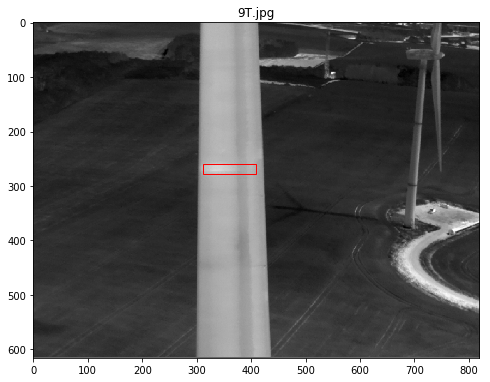

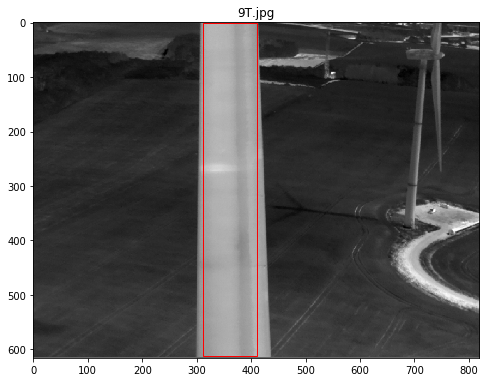

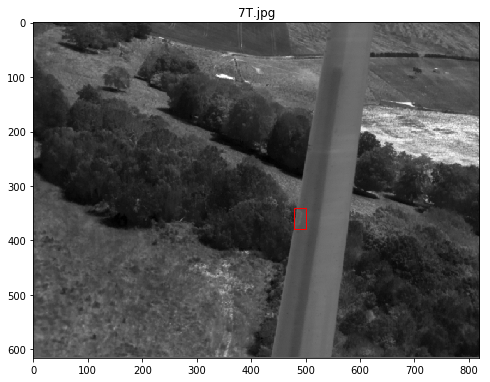

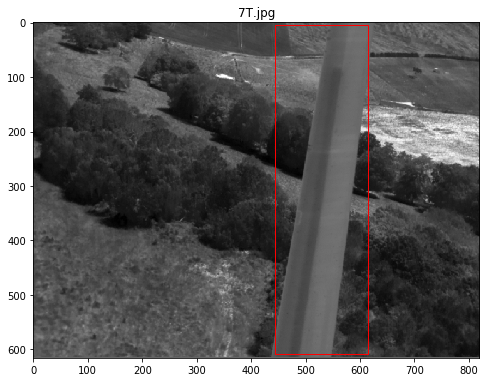

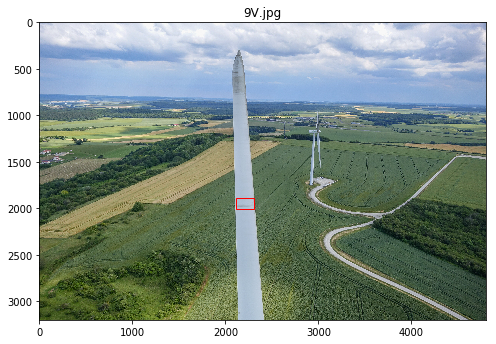

...

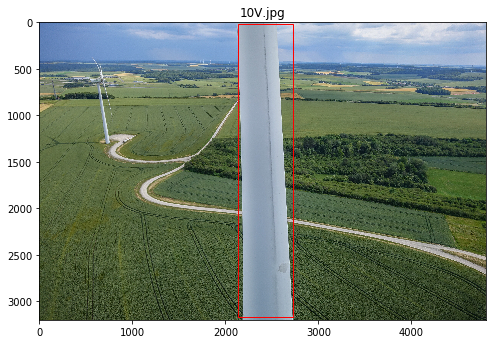

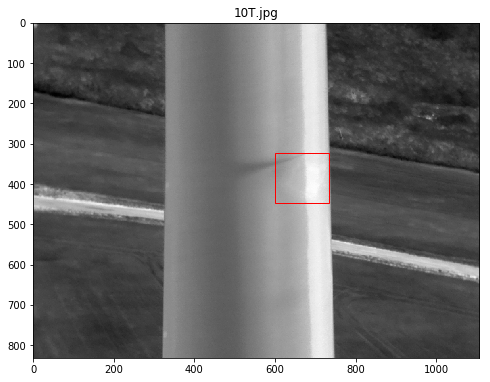

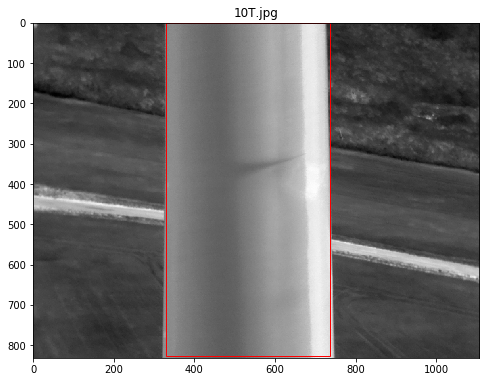

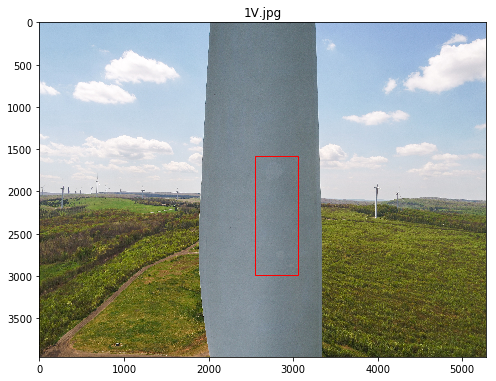

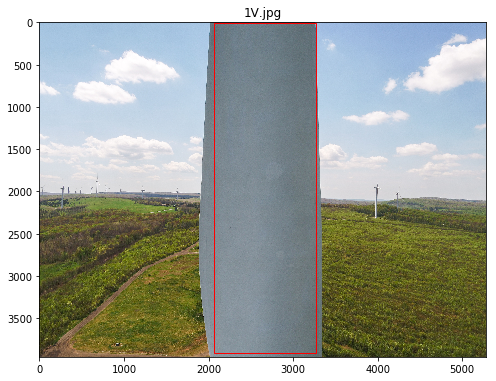

In [123]:
for i,row in df_Repair_defects_bounding_box.iterrows():
    filename= row['Filename']
    flag_T = 'T.jpg' in filename
    flag_T_image = 0
    if flag_T:
        index = Repair_defects_T_Order.index(filename)
    else:
        index = Repair_defects_V_Order.index(filename)
    
    plt.figure(figsize=(8,8))
    if flag_T:
        plt.imshow(Repair_defects_T[index])
    else:
        plt.imshow(Repair_defects_V[index])
    ax = plt.gca()
    
    """
    a=(df_Repair_defects_bounding_box.iloc[i,2],df_Repair_defects_bounding_box.iloc[i,3])
    b=(df_Repair_defects_bounding_box.iloc[i,6],df_Repair_defects_bounding_box.iloc[i,7])
    c=(df_Repair_defects_bounding_box.iloc[i,4],df_Repair_defects_bounding_box.iloc[i,5])
    d=(df_Repair_defects_bounding_box.iloc[i,8],df_Repair_defects_bounding_box.iloc[i,9])
    """
    a=(df_Repair_defects_bounding_box.iloc[i,3],df_Repair_defects_bounding_box.iloc[i,4])
    b=(df_Repair_defects_bounding_box.iloc[i,7],df_Repair_defects_bounding_box.iloc[i,8])
    c=(df_Repair_defects_bounding_box.iloc[i,5],df_Repair_defects_bounding_box.iloc[i,6])
    d=(df_Repair_defects_bounding_box.iloc[i,9],df_Repair_defects_bounding_box.iloc[i,10])

    y1 = min(a[1],b[1],c[1],d[1])
    y2 = max(a[1],b[1],c[1],d[1])
    x1 = min(a[0],b[0],c[0],d[0])
    x2 = max(a[0],b[0],c[0],d[0])

    width = abs(c[0] - a[0])
    height = abs(d[1] - a[1])
    rect = Rectangle((x1, y1), width, height, fill=False, color='red')
    # draw the box
    ax.add_patch(rect)
    plt.title(filename)
    plt.show()
    

### For images with no defects

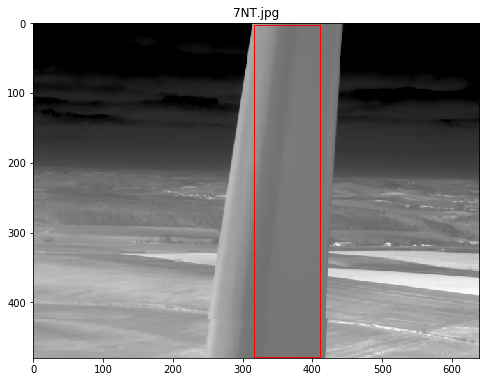

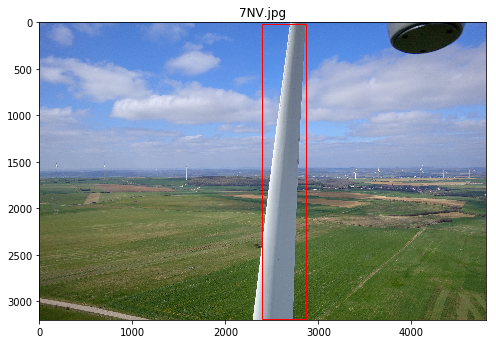

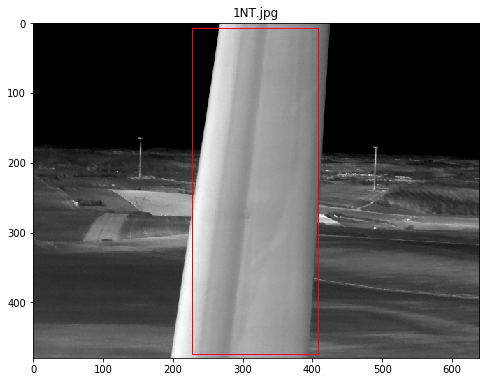

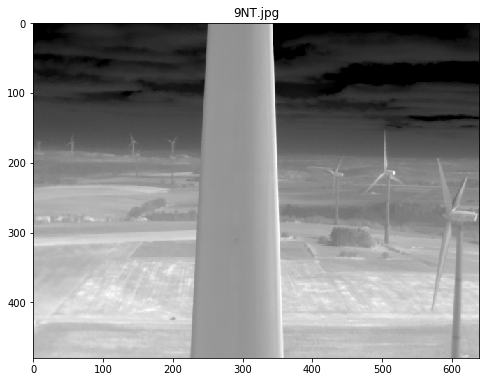

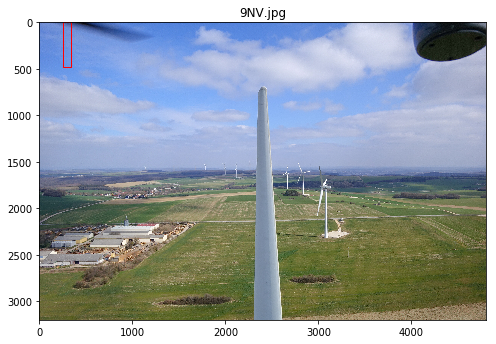

...

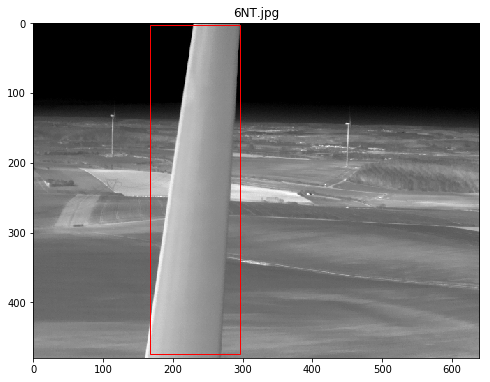

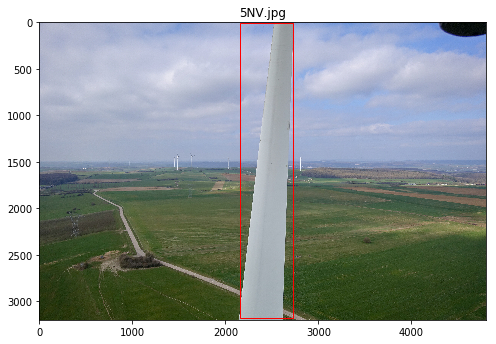

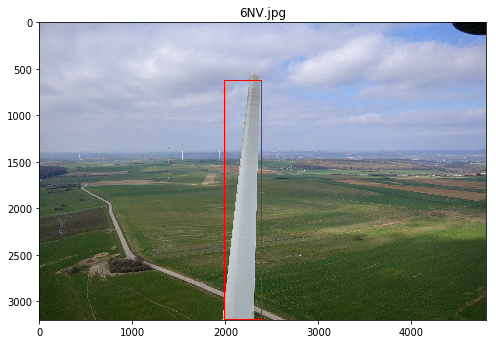

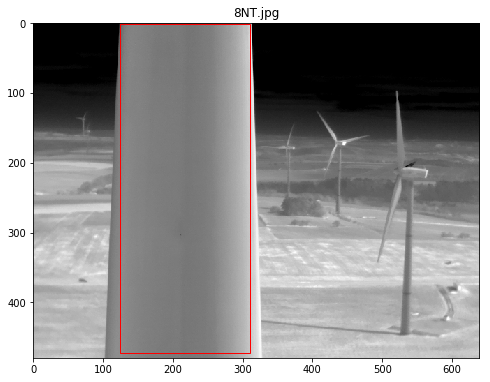

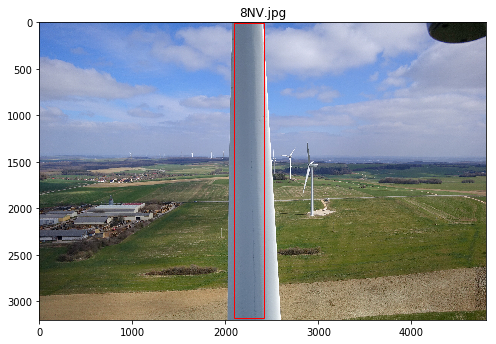

In [124]:
for i,row in df_No_defects_bounding_box.iterrows():
    filename= row['Filename']
    flag_T = 'T.jpg' in filename
    flag_T_image = 0
    if flag_T:
        index = No_defects_T_Order.index(filename)
    else:
        index = No_defects_V_Order.index(filename)
    
    plt.figure(figsize=(8,8))
    if flag_T:
        plt.imshow(No_defects_T[index])
    else:
        plt.imshow(No_defects_V[index])
    ax = plt.gca()

    #a=(df_No_defects_bounding_box.iloc[i,2],df_No_defects_bounding_box.iloc[i,3])
    #b=(df_No_defects_bounding_box.iloc[i,6],df_No_defects_bounding_box.iloc[i,7])
    #c=(df_No_defects_bounding_box.iloc[i,4],df_No_defects_bounding_box.iloc[i,5])
    #d=(df_No_defects_bounding_box.iloc[i,8],df_No_defects_bounding_box.iloc[i,9])
    
    
    a=(df_No_defects_bounding_box.iloc[i,3],df_No_defects_bounding_box.iloc[i,4])
    b=(df_No_defects_bounding_box.iloc[i,7],df_No_defects_bounding_box.iloc[i,8])
    c=(df_No_defects_bounding_box.iloc[i,5],df_No_defects_bounding_box.iloc[i,6])
    d=(df_No_defects_bounding_box.iloc[i,9],df_No_defects_bounding_box.iloc[i,10])
    
    y1 = min(a[1],b[1],c[1],d[1])
    y2 = max(a[1],b[1],c[1],d[1])
    x1 = min(a[0],b[0],c[0],d[0])
    x2 = max(a[0],b[0],c[0],d[0])

    width = abs(c[0] - a[0])
    height = abs(d[1] - a[1])
    rect = Rectangle((x1, y1), width, height, fill=False, color='red')
    # draw the box
    ax.add_patch(rect)
    plt.title(filename)
    plt.show()
    

Problem with annotation for 4 images - <br>
9NT.jpg and 10NT.jpg - No bounding box is being plotted <br>
9NV.jpg and 10NV.jpg - Bounding box is being plotted in the wrong location

### Stroing all images in a single folder

In [130]:
#Getting sub directories under the mail folder
main_folder = "Repair_Damage_2/*"
folders = glob.glob(main_folder)
print(folders)

['Repair_Damage_2/Repair_defects', 'Repair_Damage_2/No_defects']


Create a folder called **Images** and a sub-folder called **001** in the same directory as **Repair_Damage** before running the below cell

### How the directory structure should look -

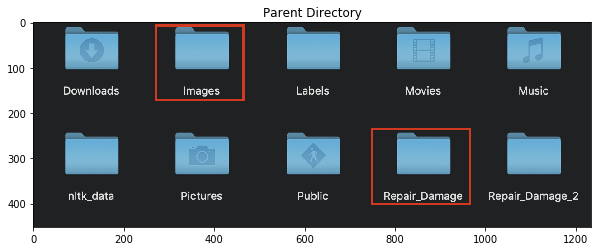

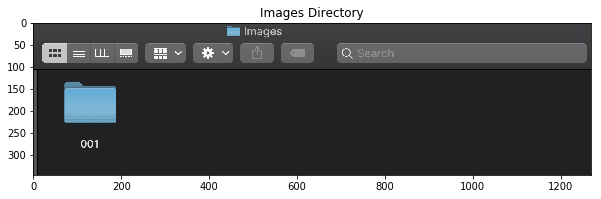

In [144]:
plt.figure(figsize=(10,10))
img = load_image("Desktop/Images_RepairDefects.png")
plt.imshow(img)
plt.title("Parent Directory")
plt.show()

plt.figure(figsize=(10,10))
img = load_image("Desktop/ImagesDirectory.png")
plt.imshow(img)
plt.title("Images Directory")
plt.show()

In [131]:
save_path = 'Images/001/'
new_image_names = []
for folder in folders:
    img_prefix = folder.split('/')[1]
    #print(img_prefix)
    
    #path to find all files under each folder
    fn_path_allfiles = folder+'/*'
    #path to find all csv file(s)(file with annotations) under each folder
    fn_path_csvfile = folder+'/*.csv'
    
    #Obtaining path of all csv files under each folder
    file_csv = glob.glob(fn_path_csvfile)
    #Obtaining path of all files under each folder
    file_all = glob.glob(fn_path_allfiles)
    
    #We only need to iterate over the folders Pair_1, Pair_2...etc.
    required_folders = list(set(file_all)^set(file_csv))
    
    for image_folder in required_folders:
        #Obtaining the path of the images under each folder
        images_path = image_folder+"/*"
        images = (glob.glob(images_path))
        #Iterating over the images
        for img in images:
            span_flag = 0
            if folder.split('/')[1] == 'Repair_defects':
                #Appending thermal images to a different list
                if re.search('T.jpg', img):
                    if re.search('\d\dT.jpg', img):
                        span = re.search('\d\dT.jpg', img).span()
                        span_flag = 1
                    if span_flag==0:
                        span = re.search('\dT.jpg', img).span()
                    start_index = span[0]
                    end_index = span[1]
                    img_num = img[start_index:end_index]
                    image_name = img_prefix+'_'+img_num
                    new_image_names.append(image_name)
                    read_img = load_image(img)
                #plt.imshow(read_img)
                #plt.show()
                    full_path = save_path+image_name
                    cv2.imwrite(full_path,read_img)
                #Appending regular images to a different list
                elif re.search('V.jpg', img):
                    if re.search('\d\dV.jpg', img):
                        span = re.search('\d\dV.jpg', img).span()
                        span_flag = 1
                    if span_flag==0:
                        span = re.search('\dV.jpg', img).span()
                    start_index = span[0]
                    end_index = span[1]
                    img_num = img[start_index:end_index]
                    image_name = img_prefix+'_'+img_num
                    new_image_names.append(image_name)
                    read_img = load_image(img)
                    full_path = save_path+image_name
                    cv2.imwrite(full_path,read_img)
            
            if folder.split('/')[1] == 'No_defects':
                #Appending thermal images to a different list
                if re.search('NT.jpg', img):
                    if re.search('\d\dNT.jpg', img):
                        span = re.search('\d\dNT.jpg', img).span()
                        span_flag = 1
                    if span_flag==0:
                        span = re.search('\dNT.jpg', img).span()
                    start_index = span[0]
                    end_index = span[1]
                    img_num = img[start_index:end_index]
                    image_name = img_prefix+'_'+img_num
                    new_image_names.append(image_name)
                    read_img = load_image(img)
                #plt.imshow(read_img)
                #plt.show()
                    full_path = save_path+image_name
                    cv2.imwrite(full_path,read_img)
                #Appending regular images to a different list
                elif re.search('NV.jpg', img):
                    if re.search('\d\dNV.jpg', img):
                        span = re.search('\d\dNV.jpg', img).span()
                        span_flag = 1
                    if span_flag==0:
                        span = re.search('\dNV.jpg', img).span()
                    start_index = span[0]
                    end_index = span[1]
                    img_num = img[start_index:end_index]
                    image_name = img_prefix+'_'+img_num
                    new_image_names.append(image_name)
                    read_img = load_image(img)
                    full_path = save_path+image_name
                    cv2.imwrite(full_path,read_img)                        

### Obtaining the Center of each bounding box

In [132]:
dfs = [df_Repair_defects_bounding_box,df_No_defects_bounding_box]

for df in dfs:
    bounding_box_X = []
    bounding_box_Y = []
    for i,row in df.iterrows():
        bounding_box_X.append((row['Bottom Left X']+row['Bottom Right X'])/2)
        bounding_box_Y.append((row['Bottom Left Y']+row['Top Left Y'])/2)
    df['Bounding Box X'] = bounding_box_X
    df['Bounding Box Y'] = bounding_box_Y

Create a folder called **Labels** and sub-folders called **001** and **Ouptut** in the same directory as **Repair_Damage** before running the below cell<br>

The **001** folder within the Labels directory, will have text files pertaining to every image after execution of the below cell.

Each text file will have the following information - <br>

**Defect number** followed by bounding box co-ordinates in the following order **Bottom Left X** **Top Right Y** **Bottom Right X** **Bottom Right Y**

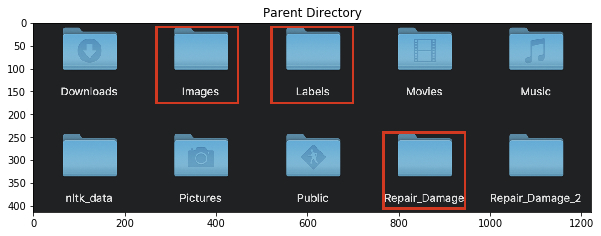

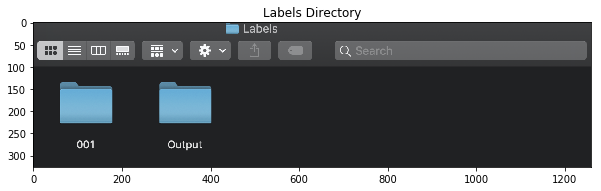

In [146]:
plt.figure(figsize=(10,10))
img = load_image("Desktop/Labels_RepairDefects.png")
plt.imshow(img)
plt.title("Parent Directory")
plt.show()

plt.figure(figsize=(10,10))
img = load_image("Desktop/LabelsDirectory.png")
plt.imshow(img)
plt.title("Labels Directory")
plt.show()

In [134]:
save_path = 'Labels/001/'
created_txt_files = []

dfs = [df_Repair_defects_bounding_box,df_No_defects_bounding_box]
df_names = ['df_Repair_defects_bounding_box','df_No_defects_bounding_box']
for i,df in enumerate(dfs):
    if "Repair_defects" in df_names[i]:
        prefix = "Repair_defects_"
    else:
        prefix = "No_defects_"
    #Iterating through each row in the above dataframes
    for i,row in df.iterrows():
        
        #Forming txt file name
        content = ''
        file_name = row['Filename']
        image_name = prefix+file_name
        image_name_split = image_name.split('.')
        txt_filename = image_name_split[0]+'.txt'
        
        #Reading defect ID
        defect = row['Damage ID']
        
        #Image Dimensions
        image_width = row['#Cols']
        image_height = row['#Rows']
        
        #Centre of Bounding box
        abs_x = row['Bounding Box X']
        abs_y = row['Bounding Box Y']
        
        #Dimensions of Bounding Box
        abs_width = abs(row['Bottom Left X']-row['Bottom Right X'])
        abs_height = abs(row['Bottom Left Y']-row['Top Left Y'])
        
        #If defect ID is 251 - the bounding box is for a defect
        if defect == 251:
            #<class_number>
            continue
            content = content+'1'
            
        #If defect ID is not 251 - the bounding box is for a blade
        else:
            #<class_number>
            content = content+'1'
            
        #[category number]
        #[bounding box left X] [bounding box top Y] [bounding box right X] [bounding box bottom Y]
        
        content = content + ' ' + str(row['Bottom Left X'])
        
        content = content + ' ' + str(row['Top Right Y'])
        
        content = content + ' ' + str(row['Bottom Right X'])
        
        content = content + ' ' + str(row['Bottom Right Y'])
        
        full_path = save_path+txt_filename
        
        #IF .txt file does not exist, create a new one and add the content
        if txt_filename not in created_txt_files:
            
            created_txt_files.append(txt_filename)
            
            file = open(full_path,"w+")
            
            file.write(content)
            
            file.close()
        
        #IF .txt file exists, add content to the existing file
        else:
            
            file = open(full_path, "a+")
            
            file.write("\n"+content)
            
            file.close()

In [133]:
df_Repair_defects_bounding_box.head()

,Filename,Damage ID,WKT coordinates,Bottom Left X,Bottom Left Y,Bottom Right X,Bottom Right Y,Top Right X,Top Right Y,Top Left X,Top Left Y,Resolution,#Cols,#Rows,Bounding Box X,Bounding Box Y
0,9T.jpg,251,"POLYGON ((0.38 0.452, 0.499 0.452, 0.499 0.42,...",311.60,278.432,409.18,278.432,409.18,258.720,311.60,258.720,820x616,820,616,360.39,268.576
1,9T.jpg,3143,"POLYGON ((0.379 0.993, 0.5 0.993, 0.5 0.002, 0...",310.78,611.688,410.00,611.688,410.00,1.232,310.78,1.232,820x616,820,616,360.39,306.460
2,7T.jpg,251,"POLYGON ((0.583 0.614, 0.61 0.614, 0.61 0.551,...",478.06,378.224,500.20,378.224,500.20,339.416,478.06,339.416,820x616,820,616,489.13,358.820
3,7T.jpg,3143,"POLYGON ((0.541 0.989, 0.749 0.989, 0.749 0.00...",443.62,609.224,614.18,609.224,614.18,4.928,443.62,4.928,820x616,820,616,528.90,307.076
4,9V.jpg,251,"POLYGON ((0.441 0.626, 0.481 0.626, 0.481 0.59...",2116.80,2003.200,2308.80,2003.200,2308.80,1888.000,2116.80,1888.000,4800x3200,4800,3200,2212.80,1945.600


In [137]:
# -*- coding: utf-8 -*-
#Function to convert the input file we provide to the input format which YOLOv3 can read
import os
from os import walk, getcwd
from PIL import Image

classes = ["001","002"]

def convert(size, box):
    dw = 1./size[0]
    dh = 1./size[1]
    x = (box[0] + box[1])/2.0
    y = (box[2] + box[3])/2.0
    w = box[1] - box[0]
    h = box[3] - box[2]
    x = x*dw
    w = w*dw
    y = y*dh
    h = h*dh
    return (x,y,w,h)
    
    
"""-------------------------------------------------------------------""" 

""" Configure Paths"""   
mypath = "Labels/001/"
outpath = "Labels/output/"

cls = "001"
if cls not in classes:
    exit(0)
cls_id = classes.index(cls)

wd = getcwd()
list_file = open('%s/%s_list.txt'%(wd, cls), 'w')

""" Get input text file list """
txt_name_list = []
for (dirpath, dirnames, filenames) in walk(mypath):
    txt_name_list.extend(filenames)
    break
# print(txt_name_list)

""" Process """
for txt_name in txt_name_list:
    # txt_file =  open("Labels/stop_sign/001.txt", "r")
    
    """ Open input text files """
    txt_path = mypath + txt_name
    print("Input:" + txt_path)
    txt_file = open(txt_path, "r")
    lines = txt_file.read().split('\n')   #for ubuntu, use "\r\n" instead of "\n"
    
    """ Open output text files """
    txt_outpath = outpath + txt_name
    print("Output:" + txt_outpath)
    txt_outfile = open(txt_outpath, "a")
    
    
    """ Convert the data to YOLO format """
    ct = 0
    for line in lines:
        #print('lenth of line is: ')
        #print(len(line))
        #print('\n')
        elems = line.split(' ')
        if(len(elems) >= 2):
        #if(len(line) >= 2):
            ct = ct + 1
            print(line + "\n")
            elems = line.split(' ')
            print(elems)
            xmin = elems[0]
            xmax = elems[2]
            ymin = elems[1]
            ymax = elems[3]
            print(elems[0])
            #
            img_path = str('%s/Images/%s/%s.jpg'%(wd, cls, os.path.splitext(txt_name)[0]))
            #t = magic.from_file(img_path)
            #wh= re.search('(\d+) x (\d+)', t).groups()
            im=Image.open(img_path)
            w= int(im.size[0])
            h= int(im.size[1])
            #w = int(xmax) - int(xmin)
            #h = int(ymax) - int(ymin)
            # print(xmin)
            print(w, h)
            print(float(xmin), float(xmax), float(ymin), float(ymax))
            b = (float(xmin), float(xmax), float(ymin), float(ymax))
            bb = convert((w,h), b)
            print(bb)
            txt_outfile.write(str(cls_id) + " " + " ".join([str(a) for a in bb]) + '\n')

    """ Save those images with bb into list"""
    if(ct != 0):
        list_file.write('%s/images/%s/%s.jpg\n'%(wd, cls, os.path.splitext(txt_name)[0]))
                
list_file.close()

Input:Labels/001/No_defects_6NV.txt
Output:Labels/output/No_defects_6NV.txt
1 0.455 0.596 0.084 0.8039999999999999

['1', '0.455', '0.596', '0.084', '0.8039999999999999']
1
4800 3200
1.0 0.596 0.455 0.084
(0.00016625000000000003, 8.421875000000001e-05, -8.416666666666668e-05, -0.0001159375)
Input:Labels/001/No_defects_4NT.txt
Output:Labels/output/No_defects_4NT.txt
1 0.41550000000000004 0.498 0.23300000000000004 0.9920000000000001

['1', '0.41550000000000004', '0.498', '0.23300000000000004', '0.9920000000000001']
1
640 480
1.0 0.498 0.41550000000000004 0.23300000000000004
(0.0011703125000000001, 0.0006755208333333334, -0.000784375, -0.0003802083333333333)
Input:Labels/001/Repair_defects_7V.txt
Output:Labels/output/Repair_defects_7V.txt
1 0.561 0.502 0.12400000000000005 0.9940000000000001

['1', '0.561', '0.502', '0.12400000000000005', '0.9940000000000001']
1
4800 3200
1.0 0.502 0.561 0.12400000000000005
(0.00015645833333333335, 0.00010703125000000002, -0.00010375, -0.0001365625)
Input:

After running the above cell, copy all the text files from the ouput file and place them in the __001__ folder of the images directory

This is how the __001__ folder will look after copying the text files - 

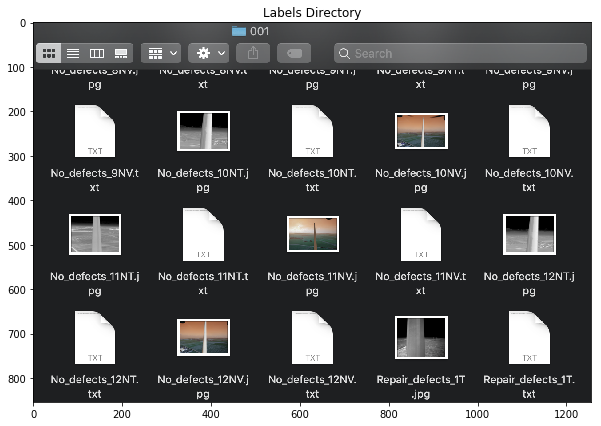

In [147]:
plt.figure(figsize=(10,10))
img = load_image("Desktop/001Folder.png")
plt.imshow(img)
plt.title("Labels Directory")
plt.show()

### Creating text files mentioning training and test images

In [152]:
import glob, os
# Current directory
#current_dir = os.path.dirname(os.path.abspath(__file__))
#print(current_dir)
current_dir = 'Images/001'
# Percentage of images to be used for the test set
percentage_test = 10;
# Create and/or truncate train.txt and test.txt
file_train = open('train.txt', 'w')  
file_test = open('test.txt', 'w')
# Populate train.txt and test.txt
counter = 1  
index_test = round(100 / percentage_test)  
for pathAndFilename in glob.iglob(os.path.join(current_dir, "*.jpg")):  
    title, ext = os.path.splitext(os.path.basename(pathAndFilename))
    if counter == index_test:
        counter = 1
        print("Test:",current_dir + "/" + title + '.jpg' + "\n")
        file_test.write(current_dir + "/" + title + '.jpg' + "\n")
    else:
        print("Train:",current_dir + "/" + title + '.jpg' + "\n")
        file_train.write(current_dir + "/" + title + '.jpg' + "\n")
        counter = counter + 1

Train: Images/001/No_defects_5NV.jpg

Train: Images/001/Repair_defects_1T.jpg

Train: Images/001/No_defects_7NT.jpg

Train: Images/001/No_defects_7NV.jpg

Train: Images/001/Repair_defects_1V.jpg

Train: Images/001/No_defects_5NT.jpg

Train: Images/001/No_defects_10NT.jpg

Train: Images/001/No_defects_12NV.jpg

Train: Images/001/No_defects_1NT.jpg

Test: Images/001/No_defects_3NV.jpg

Train: Images/001/No_defects_3NT.jpg

Train: Images/001/No_defects_1NV.jpg

Train: Images/001/No_defects_12NT.jpg

Train: Images/001/No_defects_10NV.jpg

Train: Images/001/No_defects_4NT.jpg

Train: Images/001/No_defects_6NV.jpg

Train: Images/001/Repair_defects_7V.jpg

Train: Images/001/Repair_defects_7T.jpg

Train: Images/001/No_defects_6NT.jpg

Test: Images/001/No_defects_4NV.jpg

Train: Images/001/No_defects_2NT.jpg

Train: Images/001/Repair_defects_6T.jpg

Train: Images/001/No_defects_11NV.jpg

Train: Images/001/No_defects_11NT.jpg

Train: Images/001/Repair_defects_6V.jpg

Train: Images/001/No_defects

Now we have all the files ready to compile a YOLO model. I followed the instructions from the blog <br>https://medium.com/@manivannan_data/how-to-train-yolov2-to-detect-custom-objects-9010df784f36

### Steps to setup darknet -<br>

1. Execute in command prompt - git clone https://github.com/AlexeyAB/darknet.git<br>

It will create a directory called **darknet** with all the files needed.<br>

2. Create the following files in the cfg directory of the darknet folder -<br>

-->__obj.data__<br>

-->__obj.names__<br>

-->__tiny-yolo.cfg__<br><br>
I've added all the three files to the google drive<br>


3. Copy the Images folder, __train.txt__ and __test.txt__ that we created into the darknet folder.<br><br>

4. We use pretrained weights to fasten the algorithm <br>

__darknet19_448.conv.23__ is a file with pre-trained weights.<br>

I've added the weights file to google drive, place the file in the darknet directory.<br>

5. Navigate to the __darknet__ folder in command prompt and run this line -<br>

./darknet detector train cfg/obj.data cfg/tiny-yolo.cfg darknet19_448.conv.23<br>



### Data Annotation in Required Format

Need not execute the cell below, I tried to directly create input files which YOLO can read, but there's a function provided to do the same which was executed above. Did this for practice purpose.

In [136]:
save_path = 'Labels/001/'
created_txt_files = []

dfs = [df_Repair_defects_bounding_box,df_No_defects_bounding_box]
df_names = ['df_Repair_defects_bounding_box','df_No_defects_bounding_box']
for i,df in enumerate(dfs):
    if "Repair_defects" in df_names[i]:
        prefix = "Repair_defects_"
    else:
        prefix = "No_defects_"
    #Iterating through each row in the above dataframes
    for i,row in df.iterrows():
        
        #Forming txt file name
        content = ''
        file_name = row['Filename']
        image_name = prefix+file_name
        image_name_split = image_name.split('.')
        txt_filename = image_name_split[0]+'.txt'
        
        #Reading defect ID
        defect = row['Damage ID']
        
        #Image Dimensions
        image_width = row['#Cols']
        image_height = row['#Rows']
        
        #Centre of Bounding box
        abs_x = row['Bounding Box X']
        abs_y = row['Bounding Box Y']
        
        #Dimensions of Bounding Box
        abs_width = abs(row['Bottom Left X']-row['Bottom Right X'])
        abs_height = abs(row['Bottom Left Y']-row['Top Left Y'])
        
        ####################################EXAMPLE OF YOLO 3 Annotations format####################################
        #####My Image Size: 360 * 480 it have one object ie:dog
        #####image_width = 360
        #####image_height = 480
        #####absolute_x = 30 (dog x position from image)
        #####absolute_y = 40 (dog y position from image)
        #####absolute_height = 200 (original height of dog from image)
        #####absolute_width = 200 (original width of dog from image)
        #####
        #####<class_number> (<absolute_x> / <image_width>) (<absolute_y> / <image_height>) (<absolute_width> / <image_width>) (<absolute_height> / <image_height>)
        #####ie:
        #####0 (30/360) (40/480) (200/360) (200/480)
        #####0 0.0833 0.0833 0.556 0.417
        
        #If defect ID is 251 - the bounding box is for a defect
        if defect == 251:
            #<class_number>
            #print("Came into if for defect")
            continue
            content = content+'1'
        #If defect ID is not 251 - the bounding box is for a blade
        else:
            #<class_number>
            #Made Changes
            content = content+'1'
        
        #(<absolute_x> / <image_width>)
        content = content + ' ' + str(abs_x/image_width)
        
        #<image_width>) (<absolute_y>
        content = content + ' ' + str(abs_y/image_height)
        
        #(<absolute_width> / <image_width>)
        content = content + ' ' + str(abs_width/image_width)
        
        #(<absolute_height> / <image_height>)
        content = content + ' ' + str(abs_height/image_height)
        
        full_path = save_path+txt_filename
        
        #IF .txt file does not exist, create a new one and add the content
        if txt_filename not in created_txt_files:
            
            created_txt_files.append(txt_filename)
            
            file = open(full_path,"w+")
            
            file.write(content)
            
            file.close()
        
        #IF .txt file exists, add content to the existing file
        else:
            
            file = open(full_path, "a+")
            
            file.write("\n"+content)
            
            file.close()

### Plotting original image and prediction

### Thermal Image

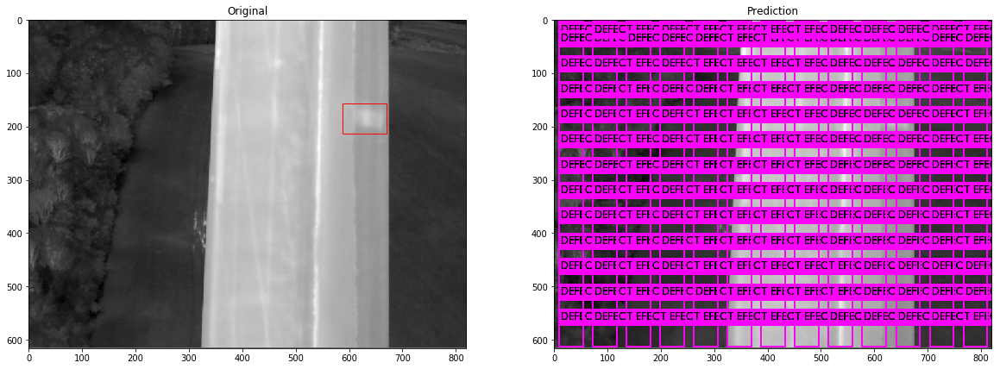

In [196]:
index = df_Repair_defects_bounding_box[(df_Repair_defects['Filename']=='5T.jpg')&(df_Repair_defects['Damage name']=='POI')]
index = index.index
img_index = Repair_defects_T_Order.index('5T.jpg')

for i in index:
    
    plt.figure(figsize=(20,20))
    plt.subplot(1, 2, 1)
    plt.imshow(Repair_defects_T[img_index])
    ax = plt.gca()

    a=(df_Repair_defects_bounding_box.iloc[i,3],df_Repair_defects_bounding_box.iloc[i,4])
    b=(df_Repair_defects_bounding_box.iloc[i,7],df_Repair_defects_bounding_box.iloc[i,8])
    c=(df_Repair_defects_bounding_box.iloc[i,5],df_Repair_defects_bounding_box.iloc[i,6])
    d=(df_Repair_defects_bounding_box.iloc[i,9],df_Repair_defects_bounding_box.iloc[i,10])

    y1 = min(a[1],b[1],c[1],d[1])
    y2 = max(a[1],b[1],c[1],d[1])
    x1 = min(a[0],b[0],c[0],d[0])
    x2 = max(a[0],b[0],c[0],d[0])

    width = abs(c[0] - a[0])
    height = abs(d[1] - a[1])
    rect = Rectangle((x1, y1), width, height, fill=False, color='red')

    # draw the box
    ax.add_patch(rect)
    plt.title('Original')
    plt.subplot(1, 2, 2)
    
    img = load_image('darknet/predictions.jpg')
    plt.imshow(img)
    plt.title('Prediction')
    plt.show()

### RGB Image

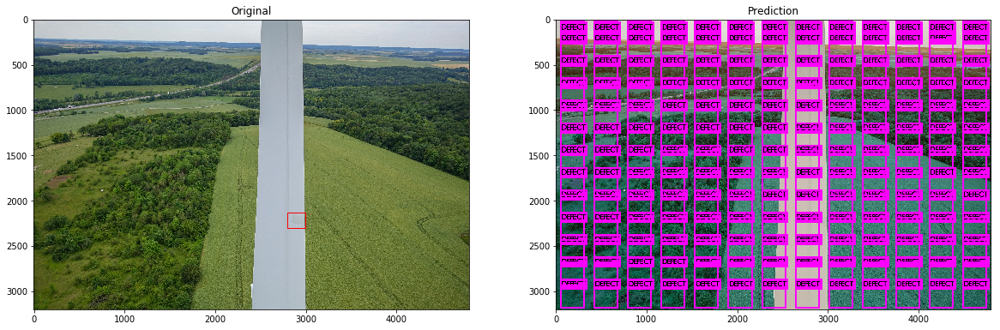

In [198]:
index = df_Repair_defects_bounding_box[(df_Repair_defects['Filename']=='5V.jpg')&(df_Repair_defects['Damage name']=='POI')]
index = index.index
img_index = Repair_defects_V_Order.index('5V.jpg')

for i in index:
    
    plt.figure(figsize=(20,20))
    plt.subplot(1, 2, 1)
    plt.imshow(Repair_defects_V[img_index])
    ax = plt.gca()

    a=(df_Repair_defects_bounding_box.iloc[i,3],df_Repair_defects_bounding_box.iloc[i,4])
    b=(df_Repair_defects_bounding_box.iloc[i,7],df_Repair_defects_bounding_box.iloc[i,8])
    c=(df_Repair_defects_bounding_box.iloc[i,5],df_Repair_defects_bounding_box.iloc[i,6])
    d=(df_Repair_defects_bounding_box.iloc[i,9],df_Repair_defects_bounding_box.iloc[i,10])

    y1 = min(a[1],b[1],c[1],d[1])
    y2 = max(a[1],b[1],c[1],d[1])
    x1 = min(a[0],b[0],c[0],d[0])
    x2 = max(a[0],b[0],c[0],d[0])

    width = abs(c[0] - a[0])
    height = abs(d[1] - a[1])
    rect = Rectangle((x1, y1), width, height, fill=False, color='red')

    # draw the box
    ax.add_patch(rect)
    plt.title('Original')
    plt.subplot(1, 2, 2)
    
    img = load_image('darknet/predictions.jpg')
    plt.imshow(img)
    plt.title('Prediction')
    plt.show()